In [6]:
from IPython.display import display, HTML , Markdown
from snowflake.snowpark.session import Session
from snowflake.snowpark.functions import udf, col
from sklearn.preprocessing import MinMaxScaler, LabelEncoder
from sklearn.metrics.pairwise import cosine_similarity, euclidean_distances
from sklearn.ensemble import RandomForestRegressor, RandomForestClassifier
from sklearn.model_selection import cross_val_score, cross_val_predict
from sklearn.metrics import r2_score
from sklearn.datasets import make_blobs
from cachetools import cached
from io import BytesIO
from PIL import Image
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
import numpy as np
import base64, json ,logging
import umap

# Import the commonly defined utility scripts using
# dynamic path include
import sys
sys.path.append('../python/lutils')
import sflk_base as L

display(Markdown("### Initialization"))
logging.basicConfig(stream=sys.stdout, level=logging.ERROR)

# Source various helper functions
%run ./scripts/notebook_helpers.py

# Define the project home directory, this is used for locating the config.ini file
PROJECT_HOME_DIR = '../../'
config = L.get_config(PROJECT_HOME_DIR)
session = L.connect_to_snowflake(PROJECT_HOME_DIR)

if(session == None):
   raise Exception(f'Unable to connect to snowflake. Validate connection information ')

session.use_role(f'''{config['APP_DB']['role']}''')
session.use_schema(f'''{config['APP_DB']['database']}.{config['APP_DB']['schema']}''')
session.use_warehouse(f'''{config['SNOW_CONN']['warehouse']}''')

df1 = session.sql('select current_user() ,current_role() ,current_database() ,current_schema();').to_pandas()
display(df1)

### Initialization

,CURRENT_USER(),CURRENT_ROLE(),CURRENT_DATABASE(),CURRENT_SCHEMA()
0,JPRUSA,SERVICESNOW_USER_ROLE,FASHION,PUBLIC


# Customer Data

## EDA on existing dataset

In [9]:
df = pd.read_csv('Customers.csv')

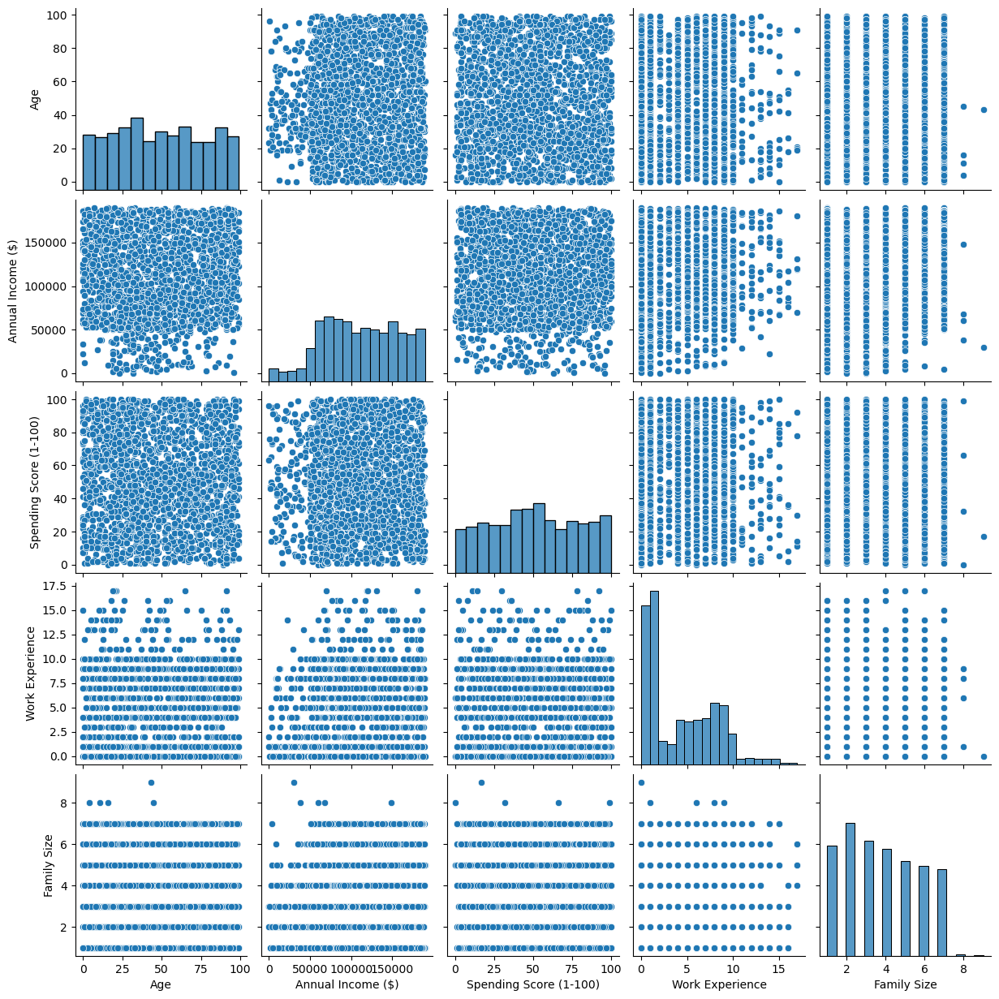

In [10]:
sns.pairplot(df.drop('CustomerID', axis=1));

In [11]:
df.groupby('Profession').mean()

,CustomerID,Age,Annual Income ($),Spending Score (1-100),Work Experience,Family Size
Profession,,,,,,
Artist,994.034314,49.004902,108776.580065,52.678105,4.215686,3.653595
Doctor,1010.571429,46.621118,111573.217391,51.900621,4.304348,3.670807
Engineer,935.692737,55.094972,111161.240223,48.966480,3.955307,3.581006
Entertainment,1061.166667,51.162393,110650.333333,52.940171,3.500000,3.888889
Executive,1072.254902,46.601307,113770.130719,49.901961,4.248366,3.967320
Healthcare,970.876106,47.843658,112574.041298,50.516224,4.002950,3.905605
Homemaker,1022.916667,45.366667,108758.616667,46.383333,6.133333,4.050000
Lawyer,957.401408,47.753521,110995.838028,48.859155,3.528169,3.619718
Marketing,1038.211765,45.823529,107994.211765,48.717647,4.305882,3.729412


In [12]:
# this data is not reflective of differences in income between professions, or relationships between
# age vs.  years of experience, years of experience vs, income etc.
# it is not very beleivable and we can generate better synthetic data.
# all we will use from this data is Gender, the rest we will generate ourselves

## synthetic data generation

In [13]:
new_df = df[['CustomerID', 'Gender']].copy()

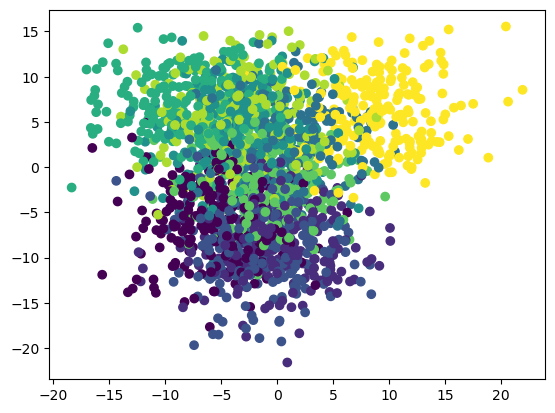

In [14]:
# We use make_blobs to create a mixture of professions vs 2 "features"
# later, we select one of these axis to map to age
# this is to simulate that age distributions varry between professions 
xy, l = make_blobs(2000,2,cluster_std=4,centers=9) 
plt.scatter(xy[:,0], xy[:,1], c=l)

In [15]:
# numbers in line with numbers found from google search 
salary_map = {
    'Marketing': 60000,
    'Artist': 40000,
    'Lawyer': 128000,
    'Homemaker': 26500,
    'Healthcare': 60000,
    'Doctor': 250000,
    'Engineer': 100000,
    'Entertainment': 50000,
    'Executive': 220000,
}

profession_map = {
    0: 'Healthcare',
    1: 'Engineer',
    2: 'Lawyer',
    3: 'Entertainment',
    4: 'Artist',
    5: 'Executive',
    6: 'Doctor',
    7: 'Homemaker',
    8: 'Marketing',
}


# some helper functions used for generating signals 
def lifestyle_func(x, a, b):
    return (x-a)**2/b

def family_helper(x):
    for k, v in family_size_map.items():
        if (x >= v[0]/100) and (x < v[1]/100):
            return k
    return -1

In [16]:
# map random clusters to age and profession
new_df['Age'] = xy[:,0]
scaler = MinMaxScaler((15,65))
new_df['Age'] = scaler.fit_transform(new_df['Age'].values.reshape(-1, 1))
new_df['Age'] = new_df['Age'].apply(lambda x: int(x))

# add profession
profession_map = {k: v for k, v in enumerate(df.Profession.unique())}
new_df['Profession'] = l
new_df['Profession'] = new_df['Profession'].apply(lambda x: profession_map[x])

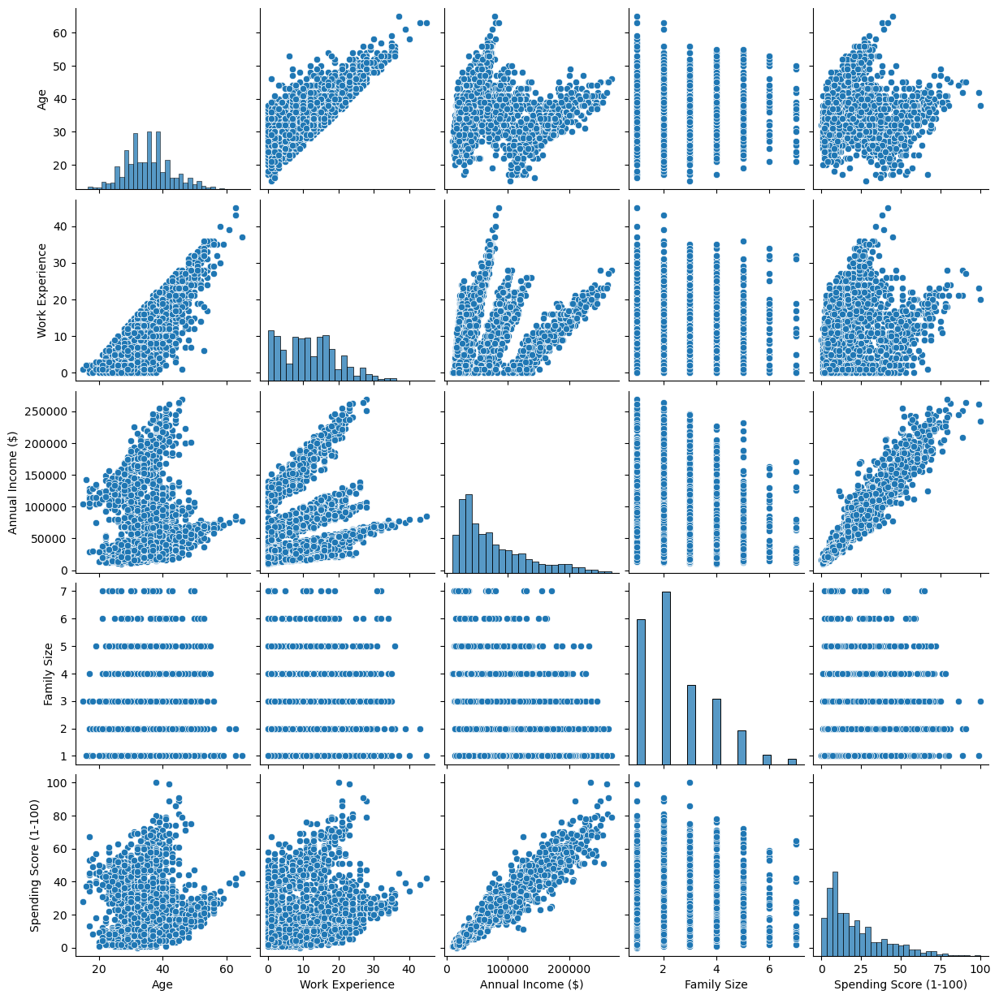

In [17]:
# in general our approach is to build signals off of age and profession while injecting noise
# features should be reasonably beleivable

# work experience should be a function of age
# someone cannot have more years of experience in their field than time in the workforce.
noise = np.abs(np.random.normal(0, 10, 2000))
new_df['Work Experience'] = (new_df['Age']-noise-15)
new_df['Work Experience'] = new_df['Work Experience'].apply(lambda x: max(3*np.random.random(),x))
scaler = MinMaxScaler((0,45))
new_df['Work Experience'] = scaler.fit_transform(new_df['Work Experience'].values.reshape(-1, 1))
new_df['Work Experience'] = new_df['Work Experience'].apply(lambda x: int(x))

# income as a function of years of experience and profession
salary_base = new_df['Profession'].apply(lambda x: salary_map[x])
experience_mult = new_df['Work Experience'].apply(lambda x: (.5+x/50))
noise = np.random.normal(0, .05, 2000)
new_df['Annual Income ($)'] = (experience_mult+noise)*salary_base

# family size, distribution follows:
# https://www.statista.com/statistics/242189/disitribution-of-households-in-the-us-by-household-size/
family_dist = [28.5, 35, 15, 12.5, 6, 2, 1]
f_ = 0
tuples  = []
for f in family_dist:
    tuples.append((f_,f_+f))
    f_ += f
family_size_map = {k+1: v for k, v in enumerate(tuples)}

new_df['Family Size'] = np.asarray([family_helper(x) for x in np.random.random(2000)])

# spending score should indicate a persons spending power/pattern
# increase with income, high at low age, high at old age, lower in middle age 
# (middle age costs are higher for house, kids, saving for retirement)
# should increase with family size as expenses increase
noise = np.random.normal(0, .125, 2000)
lifestyle = lifestyle_func(new_df['Age'], 35, 1000)+noise+(new_df['Family Size']/7+2)/3
new_df['Spending Score (1-100)'] = lifestyle*new_df['Annual Income ($)']
scaler = MinMaxScaler((0,100))
new_df['Spending Score (1-100)'] = scaler.fit_transform(new_df['Spending Score (1-100)'].values.reshape(-1, 1))
new_df['Spending Score (1-100)'] = new_df['Spending Score (1-100)'].apply(lambda x: int(x))

sns.pairplot(new_df.drop('CustomerID', axis=1));

# Fashion and Demographic Affinity

In [18]:
# retreive embeddings from snowflake
sdf_ = session.table('IMAGES_ENCODED')
embeddings = sdf_.to_pandas()
embeddings.head()

,LABEL,NAME,DATA,TEXT,EMBEDDING
0,shirt,shirt_fd28f175-6ac7-4506-b67b-ae1bcbfc5c61.jpg,/9j/4AAQSkZJRgABAQAAAQABAAD/2wBDAAgGBgcGBQgHBw...,the shirt is a black and white checkered shir...,"[0.168, 0.482, 2.44, 1.444, 2.07, 0.132, 0.487..."
1,images,images_original_c6dff4a3-76cd-4c57-be6e-7ea463...,/9j/4AAQSkZJRgABAQAAAQABAAD/2wBDAAgGBgcGBQgHBw...,"the pants are navy blue, size small\n","[1.505, 0.281, 0.614, 0.066, 0.377, 0.078, 0.8..."
2,t,t_shirt_0f4428f4-7d85-4d6d-aaa2-65c220a26dd8.jpg,/9j/4AAQSkZJRgABAQAAAQABAAD/2wBDAAgGBgcGBQgHBw...,"i can't make everyone happy, but i can make e...","[1.685, 0.083, 1.345, 1.598, 1.402, 0.704, 1.5..."
3,images,images_original_7e55a181-6e0a-4f47-9d83-ffe083...,/9j/4AAQSkZJRgABAQAAAQABAAD/2wBDAAgGBgcGBQgHBw...,"the shirt is white, with palm trees and the w...","[0.867, 1.573, 1.236, 1.581, 0.664, 1.288, 0.5..."
4,shoes,shoes_d44b95d4-ad70-4821-85d5-397f06d28df5.jpg,/9j/4AAQSkZJRgABAQAAAQABAAD/2wBDAAgGBgcGBQgHBw...,the shoes are made of leather and have a bow\n,"[0.844, 1.439, 2.989, 0.005, 0.086, 0.112, 0.0..."


## Embedding Exploration

For modeling, we need to have compatibility scores for user+ embedding pairings. Since our dataset is synthetic we need to have a means of generating these scores based on user features AND embeddings. Thus, its important to explore the embedding space and find a means of determining user affinity for a given item of clothing.

In [13]:
# we opt to exlude image categories that are infrequent, or overly vague.
embeddings = embeddings[~embeddings.LABEL.isin(['shoes', 'not', 'images', 'other', 'hat', 'body'])]
embed_data = np.stack(embeddings.EMBEDDING.apply(lambda x: np.array(eval(x))))

In [14]:
# we use umap to project our embeddings into 2 dimensions to faciliate visualization of our embeddings
reducer = umap.UMAP()

In [15]:
embedding = reducer.fit_transform(embed_data)
embedding.shape

(4425, 2)

In [16]:
# the bokeh library enables us to create interactive plots with mouse over
# visualizations of images to help us explore our embeddings
from bokeh.plotting import figure, show, output_notebook
from bokeh.models import HoverTool, ColumnDataSource, CategoricalColorMapper
from bokeh.palettes import Category20
output_notebook()

Loading BokehJS ...

In [17]:
def embeddable_image(data):
    image = Image.open(BytesIO(base64.b64decode(data))).resize((64, 64), Image.Resampling.BICUBIC)
    buffer = BytesIO()
    image.save(buffer, format='png')
    for_encoding = buffer.getvalue()
    return 'data:image/png;base64,' + base64.b64encode(for_encoding).decode()

images_df = pd.DataFrame(embedding, columns=('x', 'y'))
images_df['label'] = [str(x) for x in embeddings.LABEL]
images_df['image'] = list(map(embeddable_image, (embeddings['DATA'].values)))

datasource = ColumnDataSource(images_df)
color_mapping = CategoricalColorMapper(factors=embeddings.LABEL,
                                       palette=Category20[14])

plot_figure = figure(
    title='UMAP projection of Fashion Embeddings',
    tools=('pan, wheel_zoom, reset')
)

plot_figure.add_tools(HoverTool(tooltips="""
<div>
    <div>
        <img src='@image' style='float: left; margin: 5px 5px 5px 5px'/>
    </div>
    <div>
        <span style='font-size: 16px; color: #224499'>Label:</span>
        <span style='font-size: 18px'>@label</span>
    </div>
</div>
"""))

plot_figure.circle(
    'x',
    'y',
    source=datasource,
    color=dict(field='label', transform=color_mapping),
    line_alpha=0.6,
    fill_alpha=0.6,
    size=4
)
show(plot_figure)

In [18]:
# From on exploring the data, we define two axis to describe clothes
# based on trends we observe as we move through the embedding space of each category
# gender and age. E.g mini skirts are associated with the female gender and a younger audience
# while simple, these two scores enable us to assign an overall affinty score for each user
# clothing pairing in a sensible manner. 
embeddings['gender_affinity'] = 0.5
embeddings['age_affinity'] = 0.5 

In [19]:
# we want to know where our centroids for each clothing type are 
centroids = {}
for label in embeddings.LABEL.unique():
    centroids[label] = embedding[embeddings.LABEL == label].mean(axis=0)

In [20]:
# distances are calulated using euclidean distance on the umap embedding space to follow 
# observations from the plotted umap projection.

# d near 0 =  jean skirts, short skirts (look youthful)
# d near 1 = frilly, pleats (look youthful)
# near centroid = standard skirts 
X = embedding[embeddings.LABEL == 'skirt']
d = euclidean_distances(X, centroids['skirt'].reshape(1,-1))
scaler = MinMaxScaler((0,1))
d = scaler.fit_transform(d)
age_affinity = d
embeddings.loc[embeddings.LABEL == 'skirt', 'gender_affinity'] = 0.95
embeddings.loc[embeddings.LABEL == 'skirt', 'age_affinity'] = age_affinity

# d near 0 =  more youthful, more colorful
# d near 1 = longer, solid dark colors
X = embedding[embeddings.LABEL == 'pants']
d = euclidean_distances(X, centroids['shorts'].reshape(1,-1))
scaler = MinMaxScaler((0,1))
d = scaler.fit_transform(d)
age_affinity = d
embeddings.loc[embeddings.LABEL == 'pants', 'age_affinity'] = 1-age_affinity

# d near 0 =  shorter, more fem
# d near 1 = longer, more masc
X = embedding[embeddings.LABEL == 'shorts']
d = euclidean_distances(X, centroids['skirt'].reshape(1,-1))
scaler = MinMaxScaler((0,1))
d = scaler.fit_transform(d)
gender_affinity = d
embeddings.loc[embeddings.LABEL == 'shorts', 'gender_affinity'] = 1-gender_affinity

# t shirts overall pretty standard, not too much we can say 
# hoodies look standard
# dress look standard across images 
embeddings.loc[embeddings.LABEL == 'dress', 'gender_affinity'] = 0.95
embeddings.loc[embeddings.LABEL == 'blouse', 'gender_affinity'] = 0.95
embeddings.loc[embeddings.LABEL == 'polo', 'gender_affinity'] = 0.25

# longsleevs near shirts look more feminine
X = embedding[embeddings.LABEL == 'longsleeve']
d = euclidean_distances(X, centroids['shirt'].reshape(1,-1))
scaler = MinMaxScaler((0,1))
d_ = 1-scaler.fit_transform(d)

# longsleevs near outerwear are more masc and more patterned
X = embedding[embeddings.LABEL == 'longsleeve']
d = euclidean_distances(X, centroids['outwear'].reshape(1,-1))
scaler = MinMaxScaler((0,1))
d = scaler.fit_transform(d)
embeddings.loc[embeddings.LABEL == 'longsleeve', 'age_affinity'] = d
d = scaler.fit_transform(d+d_)
embeddings.loc[embeddings.LABEL == 'longsleeve', 'gender_affinity'] = d

# blazers near center are more feminine
X = embedding[embeddings.LABEL == 'blazer']
d = euclidean_distances(X, centroids['blazer'].reshape(1,-1))
scaler = MinMaxScaler((0,1))
d = 1-scaler.fit_transform(d)
embeddings.loc[embeddings.LABEL == 'blazer', 'gender_affinity'] = d

# shirts farther from outerwear = more masc
X = embedding[embeddings.LABEL == 'shirt']
d = euclidean_distances(X, centroids['outwear'].reshape(1,-1))
scaler = MinMaxScaler((0,1))
d = 1-scaler.fit_transform(d)
embeddings.loc[embeddings.LABEL == 'shirt', 'gender_affinity'] = d

# undershirts more fem closer to dresses
X = embedding[embeddings.LABEL == 'undershirt']
d = euclidean_distances(X, centroids['dress'].reshape(1,-1))
scaler = MinMaxScaler((0,1))
d = 1-scaler.fit_transform(d)
embeddings.loc[embeddings.LABEL == 'undershirt', 'gender_affinity'] = d

## Final Dataset

In [21]:
# we sample 1000 users and 20 impressions each 
all_impressions = []
for row in new_df.sample(1000).iterrows():
    user_impressions = embeddings[['NAME', 'LABEL', 'EMBEDDING', 'gender_affinity', 'age_affinity']].sample(20)
    for col, value in zip(row[1].index, row[1]):
        user_impressions[col] = value
    all_impressions.append(user_impressions)
all_impressions = pd.concat(all_impressions)

In [24]:
# we also create the final dataset for testing
all_impressions1 = []
for row in new_df.sample(1000).iterrows():
    user_impressions = embeddings[['NAME', 'LABEL', 'EMBEDDING', 'gender_affinity', 'age_affinity']]
    for col, value in zip(row[1].index, row[1]):
        user_impressions[col] = value
    all_impressions1.append(user_impressions)
all_impressions1 = pd.concat(all_impressions1)
all_impressions1

,NAME,LABEL,EMBEDDING,gender_affinity,age_affinity,CustomerID,Gender,Age,Profession,Work Experience,Annual Income ($),Family Size,Spending Score (1-100)
0,dress_bac70656-a50a-4a13-8c3f-63e3a0a28338.jpg,dress,"[0.962, 0.408, 0.454, 1.504, 0.275, 3.43, 0.22...",0.950000,0.500000,70,Female,45,Artist,26,40051.399008,2,7
1,shirt_3d20c462-34a4-4501-9c91-f6d3a9684715.jpg,shirt,"[4.016, 3.431, 0.147, 0.592, 1.515, 3.417, 0.8...",0.915309,0.500000,70,Female,45,Artist,26,40051.399008,2,7
3,hoodie_27895f13-d204-4cd0-9c05-816692747854.jpg,hoodie,"[1.078, 1.513, 0.454, 0.281, 1.774, 1.488, 3.4...",0.500000,0.500000,70,Female,45,Artist,26,40051.399008,2,7
5,t_shirt_7d7e5eb4-3916-4a69-826a-4facc149497b.jpg,t,"[0.864, 0.035, 0.901, 0.689, 0.011, 1.751, 0.4...",0.500000,0.500000,70,Female,45,Artist,26,40051.399008,2,7
6,blazer_18741138-5ba2-46c3-af17-ea9450ff4356.jpg,blazer,"[1.354, 3.886, 1.764, 0.536, 4.268, 0.965, 1.6...",0.790108,0.500000,70,Female,45,Artist,26,40051.399008,2,7
...,...,...,...,...,...,...,...,...,...,...,...,...,...
5756,pants_361cbb64-95f4-4be3-a01c-3aba98fa509f.jpg,pants,"[0.607, 0.778, 0.595, 0.272, 0.309, 0.947, 0.3...",0.500000,0.900798,1044,Female,49,Healthcare,24,54749.974070,1,8
5757,t_shirt_1dfed9b7-d0c3-4c6b-aa8b-e827b3558c0c.jpg,t,"[0.731, 0.077, 1.503, 0.287, 0.306, 0.577, 0.0...",0.500000,0.500000,1044,Female,49,Healthcare,24,54749.974070,1,8
5758,t_shirt_fb84b8f2-c90f-4adf-8732-0d19dff26ae2.jpg,t,"[0.076, 1.813, 0.55, 2.148, 2.85, 1.042, 0.339...",0.500000,0.500000,1044,Female,49,Healthcare,24,54749.974070,1,8
5760,t_shirt_0ff8c31c-ec64-41f2-b19e-82a36c0fa56e.jpg,t,"[1.142, 0.571, 0.872, 0.51, 1.693, 0.527, 1.85...",0.500000,0.500000,1044,Female,49,Healthcare,24,54749.974070,1,8


In [26]:
session.create_dataframe(all_impressions1).write.save_as_table(table_name='Final_Personalization_Full', mode='overwrite') 

In [30]:
all_impressions.shape

(20000, 13)

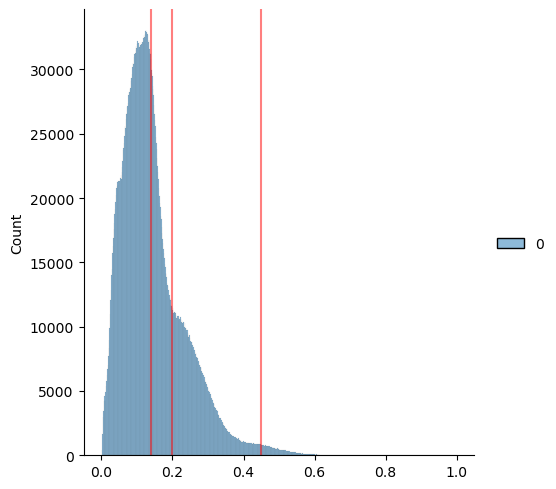

In [31]:
# Affinity score
# based on gender affinity, age affinity and spending score 
# noise is also injected to ensure the relationship is not trivial to model

# gender
gender = all_impressions1.Gender.astype('category').cat.codes
gender_affinity = all_impressions1.gender_affinity
gender_score = np.abs(gender-gender_affinity)

# age
# simple linear for now
age = ((all_impressions1.Age-15)/50)
age_affinity = all_impressions1.age_affinity
age_score = 1-np.abs(age-age_affinity)

# a, b and c control the influence of age, gender and spending score respectively
a = 1
b = 1
c = 1
noise = np.random.normal(0, .025, len(all_impressions1))
spending_score = all_impressions1['Spending Score (1-100)']/100
score = (((1+noise)*(a*age_score.values+b*gender_score.values+c*spending_score)/(a+b+c)).values)**3
scaler = MinMaxScaler((0,1))
score = scaler.fit_transform(score.reshape(-1,1))
# plot score distribution, most pairings are neutral
sns.displot(score)
plt.axvline(.14, color='red', alpha=.5);
plt.axvline(.2, color='red', alpha=.5);
plt.axvline(.45, color='red', alpha=.5);

In [40]:
(score >= .45).mean()

0.03845

In [34]:
# final dataset creation, user features+embeddings features and target variable (score)
all_impressions1['score'] = score
dataset = all_impressions1[['CustomerID', 'NAME', 'score', 'Gender', 'Age',
       'Profession', 'Work Experience', 'Annual Income ($)',
       'Spending Score (1-100)', 'Family Size', 'EMBEDDING']].copy().reset_index(drop=True)

# embedding_array = np.stack(all_impressions1.EMBEDDING.apply(lambda x: np.array(eval(x))))
# embeddings_only = pd.DataFrame(embedding_array, columns=['embedding_'+str(i)for i in range(512)])

#dataset = pd.concat([dataset, embeddings_only], axis=1)
#dataset.to_csv('final_df.csv', index=False)

In [42]:
dataset = dataset.rename(columns={'CustomerID': 'CUSTOMERID',
 'NAME': 'NAME',
 'score': 'SCORE',
 'Gender': 'GENDER',
 'Age': 'AGE',
 'Profession': 'PROFESSION',
 'Work Experience': 'WORK_EXPERIENCE',
 'Annual Income ($)': 'ANNUAL_INCOME',
 'Spending Score (1-100)': 'SPENDING_SCORE',
 'Family Size': 'FAMILY_SIZE',
 'EMBEDDING': 'EMBEDDINGS'})

In [54]:
def score_to_click(score):
    if score<.14:
        return ['Seen']
    elif score <.2:
        return ['Seen','Click']
    elif score <.45:
        return ['Seen', 'Click', 'Add2Cart']
    else:
        return ['Seen', 'Click', 'Add2Cart', 'Purchase']

dataset['Clickstream']=[score_to_click(i) for i in dataset.SCORE]
# dataset_new=dataset.explode('Clickstream')
# dataset_new

In [55]:
dataset['INTERACTION'] = dataset.Clickstream.apply(lambda x: len(x)-1)

In [56]:
sdf = session.create_dataframe(dataset)

In [57]:
sdf.write.save_as_table(table_name='Final_Personalization_Full', mode='overwrite') 

In [58]:
sdf.columns

['CUSTOMERID',
 'NAME',
 'SCORE',
 'GENDER',
 'AGE',
 'PROFESSION',
 'WORK_EXPERIENCE',
 'ANNUAL_INCOME',
 'SPENDING_SCORE',
 'FAMILY_SIZE',
 'EMBEDDINGS',
 '"Clickstream"',
 'INTERACTION']

In [30]:
import random
from random import randrange
import datetime 


def random_date(start,l):
   current = start
   while l >= 0:
      curr = current + datetime.timedelta(minutes=randrange(60))
      yield curr
      l-=1

def date_generator(n):
    startDate = datetime.datetime(2022, 9, random.randint(1,30),random.randint(0,12),random.randint(0,59))
    dates=[]
    for x in random_date(startDate,n-1):
        dates.append(x.strftime("%d/%m/%y %H:%M"))
    return dates

click_dates=[date_generator(i) for i in dataset_new.groupby('CustomerID').count().NAME]

from functools import reduce
from operator import concat

flatlist = reduce(concat, click_dates)
dataset_new['Date']=flatlist
dataset_new.to_csv('clickstream.csv', index=False)

In [38]:
dataset_new
session.create_dataframe(dataset_new).write.save_as_table(table_name='Final_Personalization', mode='overwrite') 

# ML modeling

In [32]:
# convert string variables to binary and 1-hot encoded
features = dataset.columns[3:-1]
X = dataset[features].copy()
X.Gender = X.Gender.astype('category').cat.codes
X = pd.get_dummies(X)

# we set up two "y"s, one for regression, one for classification
# for classification, we assume the top 10% scoring impressions are conversions  
y = dataset.score.copy()
y_classification = (y > np.percentile(y,90)).astype('int')

In [33]:
# train a random forest classifier with 5-fold cv, roc auc > 0.90
clf = RandomForestClassifier(n_estimators=100, max_features='sqrt', n_jobs=-1)
cross_val_score(clf, X, y_classification, scoring='roc_auc', cv=5)

array([0.91563646, 0.91532639, 0.91299271, 0.89512292, 0.9069059 ])

Text(0.5, 1.0, 'R2: 0.5659802700653954')

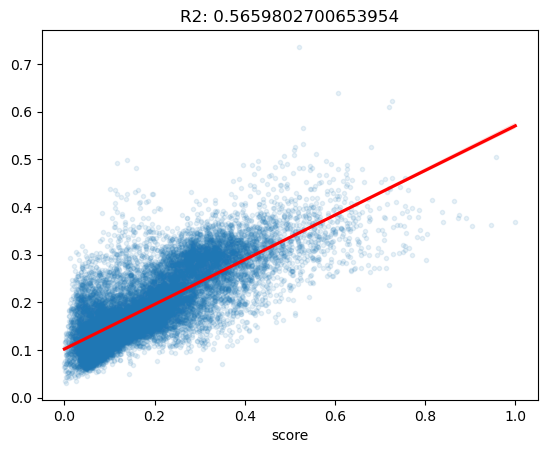

In [34]:
# also plot y vs y_pred for the regression task and to visualize the relationship between 
# model prediction and actual score. This helps visualize this ML tasks difficulty

clf = RandomForestRegressor(n_estimators=100, max_features='sqrt', n_jobs=-1)
y_pred = cross_val_predict(clf, X, y, cv=5)
sns.regplot(x=y, y=y_pred, marker='.', line_kws={'color': 'r'}, scatter_kws={'alpha': .1})
plt.title('R2: '+str(r2_score(y, y_pred)))